# Reinforcement Learning

### Prashant Madaan

# I. Overview

The objective of this notebook is to learn and apply reinforcement learning methodologies. Reinforcement learning is very simmilar to how humans and animals learn. We reward the desired behviour or punish the undesired behaviour.A simple example would be if a child completes homework before bedtime gets a treat. Some common terminologies in RL are:

1. Reward: This is a feedback signal to the agent to indicate how good or bad is the agent performing.
2. State: Represents the curent and future/past states of a problem.
3. Action: The agent performs certain action that change the environment or the state. 
4. Policy: This defines a statergy for chosing an action given a state to maximize the rewards earned by the agent.

We learnt about the MDP model and various ways to solve them. We also learnt about the TD learning methods. In this assignment, we are solving two questions:
1. The Maze Problem
2. One card Poker Problem.

We will be using Q learning to solve these problems. Q learning is an app

# One-Card Poker  

![](http://www.poker-vibe.com/poker/terms/case-card/Case-Card.jpg)

<font color="red"> Game Introduction and Rules: </font>
1. This is a 1-card poker game. Where each player can blindly bet from 0 (fold), 1, 2 or 3 in the first round. In the next round only the player who havent matched the max amount( from all the players) will be given a chance to bet additional amount to match or fold. 


2. Each player will be able to see his/her own card and the total pot balance and all other player's balance and their current bet on for the round i.e this is what you can call the current state of the game. <br>

    a. <font color="red"> Example1 </font>: 3 players in game i.e. player1, computer1, computer2. First round, player1        bets 3, computer1 bets 2 and computer2 bets 1. Next round only computer1 and computer2 will be given a chance          to match the bet as player1 has max bet so computer1's available actions will be (0, 1) and computer2's                available actions will be (0, 2).<br>
    
    b. After they match or fold the result will be given. <br>
    
    c. This case is applicable for player1 being the one who needs to match. <font color="red"> Example2 </font>: 3          players in game i.e player1, computer1, computer2. First round, player1 bets 1, computer1 bets 2 and                  computer2 bets 3. Next round only player1 and computer1 will have chance to bet and match or fold. <br>
       
    d. The examples described above will be 1 round each, this will continue until player1 losses all the money or            computer1 and computer2 will be out of money. <br>
    
This is a local version of the game, your final competition if you decide to participate will be hosted on server. The local version, you can add multiple computer players in the game but only single agent.

This way you can train your agent to play against 1,2,3,4 


### One Card Poker Description
The One card poker game is a simple card game where the player with high card wins. There can be maximum 2 rounds in the game. All the actions available to a player at the start of the game are following: 
1. The player can match the bet
2. The player can fold 
3. The player can raise the bet 
4. The player can pass

Following are the permitted bet amounts in the game: 
1. 0
2. 1
3. 2
4. 3

At any point in the game they player can see his own card, his current balance, the pot balance and the opponent's balance. 
As the game starts, the first round of betting starts, now either the player matches the bet , folds or raises. When the player folds, they get out of this current game/deal. If there are two or more players who did not fold in the first round  the game continues to the second round where each player has to either match or fold. At the end the winner with the high card wins.

There can be two outcomes of the game:
1. A player wins.
2. The match is a draw.

## One-Card Poker Environment

In [57]:
import copy
deck = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
def draw_card():
    return deck[np.random.randint(1, 13)]

In [58]:
class Player():
    """
        
        Player class to create a player object.
        eg: player = Player("player1", start_balance = 10, is_computer = 0)
        Above declaration will be for your agent. Only one non-computer
        player allowed in the local poker instance.
        However, you can create as many as you want computer_players 
        (test for 3 players but you can try more) i.e
        computer = Player("computer", start_balance = 10, is_computer = 1).
        All the player names should be unique or else you will get error.
        
    """
    def __init__(self, player_name, start_balance = 10, is_computer = 0):
        self.player_name = player_name
        self.card = None
        self.total_balance = start_balance
        self.current_bet = 0
        self.is_computer = is_computer
        self.is_active = 0
        self.number_of_turn = 0
        self.match_bet = False
    
    def get_info(self):
        print("Player name: {}".format(self.player_name))
        print("Player card: {}".format(self.card))
        print("Player total_balance: {}".format(self.total_balance))
        print("Player is_active: {}".format(self.is_active))
        

## The Poker Environment
The Poker class forms the poker environment and is the base class to train the RL agent. The class provides the basic functionality where it enforces the constraints of the game and enables the state transition. Following are some important methods and their purpose: 

1. Init Method: The intit method allows the user to create the environment and declare the number of players.
2. add_player: This methods is is used to add players to the game. 
3. get_current_state: This method returns the current state of the game. E.g.: other_stats': [[9, 1] ,[9, 1]], 'total_pot_balance': 2, 'player_stats': [6, 9, 1]}
4. get_valid_actions: It returns a valid action for the player depending on the current state of the game i.e. current player balance and the current round. 
5. check_and_remove_players: This methods checks if the player has balance or not to play. If the balance is 0 the player gets removed. 
6. deal: This function intializes the game and checks if the game is over or not. 
7. player_play: This method facilitates the player's turn and return the result as a form of the updated state and reward etc. 
8. settle_balance: This function calculates the rewards and make the appropriate balance changes after each round. 
9. return_winner: This fucntions calculates the winner by checking high card and returns it. 
10. computer_play: This functions facilitates the computer's turn.

In [59]:
class Poker():
    """
        Poker class will be the environment. 
        Important functions for users:
        1. Init Poker class i.e poker = Poker(number_of_player = 2)
           <Please dont add more than the number you declare here)
        2. add_player(player1) - adds player1 object to the game.
        3. get_current_state - gets the current state of the env
           {'other_stats': [[9, 1] ,[9, 1]], 'total_pot_balance': 2, 'player_stats': [6, 9, 1]}
           other_stats will contain the opponent information's balance and their current bet
           total_pot_balance will have total bet played by all players
           player_stats will contain player_card, player total balance, player current bet
        4. get_valid_actions -  returns the valid action available for the player
           based on balance and which round the player is in. You should take actions
           based on the return value.
           
    
    """
    def __init__(self, number_of_player = 2):
        self.all_players = []
        self.total_players = number_of_player
        self.total_pot_balance = 0
        self.player = None
        self.actions = [0, 1, 2, 3]
        self.number_of_turn = 0
        self.max_bet = 0
        
    def add_player(self, player_class):
        if player_class not in self.all_players and self.total_players > 0:
            self.all_players.append(player_class)
            self.total_players -= 1
            if player_class.is_computer == 0:
                if self.player == None:
                    self.player = player_class
                else:
                    raise Exception("Will override current player ! Only one non-computer player allowed !")
        else:
            raise Exception("Maximum number of player allowed: {}. You can increase the player count while initializing the environment".format(len(self.all_players)))
    
    def check_and_remove_players(self):
        player_remove, game_end = [], False
        for _player in self.all_players:
            if _player.total_balance <= 1:
                player_remove.append(_player)
        if len(player_remove) > 0:
            if self.player not in player_remove:
                for player in player_remove:
         #           print("Removing player: {} due to insufficient funds !!".format(player.player_name))
                    self.all_players.remove(player)                    
            else:
          #      print("Player doesnt have balance !")
                game_end = True
                
                
    def deal(self):
        reset_game = False
        self.total_pot_balance = 0
        self.number_of_turn = 0
        
        if self.check_and_remove_players():
            reset_game = True
        else:
            if len(self.all_players) == 1:
                reset_game = True
            else:
                for _player in self.all_players:
                    if _player.total_balance > 1:
                        _player.card = draw_card()
                        _player.total_balance -= 1
                        _player.current_bet = 1
                        _player.is_active = 1
                        _player.number_of_turn = 0
                        _player.match_bet = False
                        self.total_pot_balance += 1
                        self.max_bet = 0
                    else:
            #            print("{} can no longer play the game !".format(_player.player_name))
                        reset_game = True        
        return reset_game
        
    def get_current_state(self):
        current_state_dict = {}
        current_state_dict['other_stats'] = [[_player.total_balance,_player.current_bet] for _player in self.all_players if _player != self.player]
        current_state_dict['total_pot_balance'] = self.total_pot_balance
        current_state_dict['player_stats'] = [self.player.card, self.player.total_balance, self.player.current_bet]
        return current_state_dict
    
    def get_valid_actions(self, player_name):
        list_player = [_player for _player in self.all_players if _player.player_name == player_name]
        if len(list_player) == 1:
            player = list_player[0] 
            if player.number_of_turn == 0:
                if player.total_balance > 3:
                    actions =  [0, 1, 2, 3]
                elif player.total_balance <= 3:
                    if player.total_balance <= 1:
                        actions = [0]
                    elif player.total_balance > 1 and player.total_balance <= 2:
                        actions =  [0, 1]
                    else:
                        actions = [0, 1, 2]
            else:
                possible_max_bet = player.total_balance - (self.max_bet - (player.current_bet - 1))
                if possible_max_bet >= 2:
                    actions = [0, self.max_bet - (player.current_bet - 1)]
                else:
                    actions = [0]                        
            return actions
        else:
            raise Exception("Invalid player name! Use the player name defined while initialzing the environment")
    
    def print_actions(self, player, action):
        if action == 0:
            print("{} folds".format(player))
        else:
            print("{} plays {}.".format(player, action))
            
    def computer_play(self):
        list_player = [_player for _player in self.all_players if _player.player_name != self.player.player_name and _player.is_active == 1 and _player.match_bet == False]
        for player in list_player:
            actions_available = self.get_valid_actions(player.player_name)    
    #        print("Available actions for: {} are {}".format(player.player_name, actions_available))
            action_taken = actions_available[np.random.randint(len(actions_available))]
            self.print_actions(player.player_name, action_taken)
            if self.max_bet == 0 and action_taken != 0 or self.max_bet < action_taken:
                self.max_bet = action_taken
            self.take_action(player.player_name, action_taken)
    
    def get_player(self, player_name):
        return_player = [player for player in self.all_players if player.player_name == player_name]
        if len(return_player) != 1:
     #       print("Invalid Player")
            return None
        else:
            return return_player[0]
        
    def take_action(self, player_name, action_taken):
        player = self.get_player(player_name)
        player.number_of_turn += 1
        if action_taken != 0:
            player.total_balance -= action_taken
            player.current_bet += action_taken
            self.total_pot_balance += action_taken
            player.is_active = 1
        else:
            player.is_active = 0
            
    def check_game(self):
        game_over = True
        if np.sum([_player.is_active for _player in self.all_players if _player != self.player]) > 0:
            game_over = False
        return game_over
     
    def return_winner(self, players):
        max_card = np.max([_player.card for _player in players])
        return [_player for _player in players if _player.card == max_card]
            

    def settle_balance(self, winner):
        reward = 0
        if winner == "draw":
            active_player = [_player for _player in self.all_players if _player.is_active]
            if len(active_player) == 0:
        #        print("Active player cards: {}".format([(_player.player_name, _player.card) for _player in self.all_players]))
                winning_players = self.all_players
            else:
       #         print("Active player cards: {}".format([(_player.player_name, _player.card) for _player in self.all_players if _player.is_active]))
                winning_players = self.return_winner(active_player)
                
            per_player_share = self.total_pot_balance / len(winning_players)
            for _player in winning_players:
                _player.total_balance += per_player_share
            if self.player in winning_players:
                reward = per_player_share
            else:
                reward = -self.player.current_bet
            
                
        if winner == "player":
            self.player.total_balance += self.total_pot_balance
            reward = self.total_pot_balance
            winning_players = [self.player]
            
        if winner == "computer":
            active_player = [_player for _player in self.all_players if _player != self.player and _player.is_active]
            winning_players = self.return_winner(active_player)
            per_player_share = self.total_pot_balance / len(winning_players)
            for _player in winning_players:
                _player.total_balance += per_player_share
            reward = -self.player.current_bet
            
     #   print("Printing winning players: {}".format(' '.join([player.player_name for player in winning_players])))
     #   print("Reward : {}".format(reward))
        return reward
        
    def check_game_return_reward(self, round_num):
   #     print("Check results for Round Number: {}".format(round_num))
        if self.check_game() and self.player.is_active == 0:
            print("Computer folds, Player folds !")
            game_over = True
            winner = "draw"
            reward = 0
            return game_over, reward, winner 
        
        elif self.check_game() and self.player.is_active:
     #       print("Computer folds, Player active !")
            game_over = True
            reward = self.total_pot_balance
            winner = "player"
            return game_over, reward, winner 
        
        elif not self.check_game() and self.player.is_active == 0:
     #       print("Computer active, Player folds !")
            game_over = True
            reward = -self.player.current_bet
            winner = "computer"
            return game_over, reward, winner 

        if round_num == 1:
     #       print("Computer active, Player active ! ")
            game_over = False
            reward = 0
            winner = "draw"
            return game_over, reward, winner 
        
        else:
     #       print("Computer active, Player active in Round 2 ! End game now !")
            game_over = True
            active_players = [player for player in self.all_players if player.is_active]
      #      print("Active player cards: {}".format([(_player.player_name, _player.card) for _player in active_players]))
            winning_players = self.return_winner(active_players)
            if self.player in winning_players:
                if len(winning_players) > 1:
                    reward = self.total_pot_balance / len(winning_players)
                    winner = "draw"
                else:
                    reward = self.total_pot_balance
                    winner = "player"
            else:
                reward = -self.player.current_bet
                winner = "computer"

            return game_over, reward, winner 
            

    
    def update_match(self):
        for player in [player for player in self.all_players if player.current_bet - 1 == self.max_bet]:
            player.match_bet = True
    
    def check_computer_status(self):
        computer_play = False
        if len([player for player in self.all_players if player.is_computer == 1 and player.match_bet == False and player.is_active == 1]) > 0:
            computer_play = True
        return computer_play
    
    def player_play(self, player_name, action_taken):
        game_over = False
        reward = 0  
        winner = None
        self.number_of_turn += 1
        
        if self.number_of_turn == 1:
            if self.max_bet == 0 and action_taken != 0 or self.max_bet < action_taken:
                self.max_bet = action_taken
            self.print_actions(player_name, action_taken)
            self.computer_play()
            self.take_action(player_name, action_taken)
            self.update_match()
            if self.player.is_active:
                if self.player.match_bet and not self.check_computer_status():
               #     print("Player and Computer both Bet Max and match !")
                    _, reward, winner = self.check_game_return_reward(round_num=1)
                    game_over = True
            else:
                if self.check_computer_status():
             #       print("Player folds, computer players are active, they will play among themselves !")
                    self.computer_play()
                game_over, reward, winner = self.check_game_return_reward(round_num=1)
                
            if game_over:
         #       print("Winner: {}".format(winner))
                new_reward = self.settle_balance(winner)
                if winner == "draw":
                    reward = new_reward
            else:
                if self.player.match_bet and self.check_computer_status():
         #           print("Player Bet Max, computer will match now !")
                    self.computer_play()
                    game_over, reward, winner = self.check_game_return_reward(round_num=2)
          #          print("Winner: {}".format(winner))
                    new_reward = self.settle_balance(winner)
                    if winner == "draw":
                        reward = new_reward
                    
            return self.get_current_state(), reward, game_over
        
        if self.number_of_turn == 2:
            self.print_actions(player_name, action_taken)
            self.take_action(player_name, action_taken)
            if self.check_computer_status():
                self.computer_play()
            game_over = True
            _, reward, winner = self.check_game_return_reward(round_num=2)
       #     print("Winner: {}".format(winner))
            new_reward = self.settle_balance(winner)
            if winner == "draw":
                reward = new_reward
        
        return self.get_current_state(), reward, game_over
    
    
        

## RLAgent for One-Card Poker

In [93]:
class RLAgentPoker: 
    """
        Reinforcement Learning Agent Model for training/testing
        with Tabular function approximation
        
    """
    
    def __init__(self, env):
        self.poker = env
        self.Q = np.zeros((13,30,7,4))
#         self.Q = np.random.randint(13,30,7,4)
    
    def greedy(self,Q, s):
        return np.argmax(Q[s[0]-1,s[1],s[2],:])  # greedy action selection

    def epsilon_greed(self, epsilon, s,available_actions):
        # TODO: Finish this function
        if np.random.rand() < epsilon:
            return available_actions[np.random.randint(len(available_actions))]
        else:
            return self.greedy(self.Q,s)
    
    def find_suitable_action(self,epsilon,s,available_actions):
        a=self.epsilon_greed(epsilon,s,available_actions)
        if a not in available_actions:
            a=available_actions[np.random.randint(len(available_actions))]
        
        return a
   
    def reset_players(self):
        #self.poker.
        self.poker.__init__(number_of_player=3)
        player1 = Player("prashant", start_balance = 10, is_computer =  0)
        computer1 = Player("computer1", start_balance = 10, is_computer = 1)
        computer2 = Player("computer2", start_balance = 10, is_computer = 1)
        self.poker.add_player(player1)
        self.poker.add_player(computer1)
        self.poker.add_player(computer2)
        
        
    
    def train(self, **params):
        
        # parameters
        gamma = params.pop('gamma', 0.99)
        alpha = params.pop('alpha', 0.1)
        epsilon= params.pop('epsilon', 0.5)
        maxiter= params.pop('maxiter', 100) 
        decay=1/maxiter
        i=0
        rtrace = []
        all_rewards=[]
        
        for j in range(maxiter):

            self.reset_players()
            rewards = []
          
          #  print("============================================================================")
            while not self.poker.deal():
                
                print("-"*50)
                print("Deal Start!")
                print("Start State: {}".format(self.poker.get_current_state()))
                s = np.asarray(self.poker.get_current_state()['player_stats'])
                s=s.astype(int)
                actions = self.poker.get_valid_actions("prashant")
                print("Available actions for: Prashant are {}".format(actions))
                action_taken = self.find_suitable_action(epsilon,s,actions)
                a=action_taken
                result = self.poker.player_play("prashant", action_taken)
                rewards.append(result[1])
                    
                s1=np.asarray(result[0]['player_stats'])
                s1=s1.astype(int)
                self.Q[(s[0]-1),s[1],s[2], a] += alpha * (result[1] + gamma * np.max(self.Q[s1[0]-1,s1[1],s1[2], :]) - self.Q[s[0]-1,s[1],s[2],a])
                s=s1
                while not result[-1]:
                   
                    actions = self.poker.get_valid_actions("prashant")
                    print("Available actions for: Prashant are {}".format(actions))
                    action_taken = self.find_suitable_action(epsilon,s,actions)
                    result = self.poker.player_play("prashant", action_taken)
                    rewards.append(result[1])
#                    
                    s1=np.asarray(result[0]['player_stats'])
                    s1=s1.astype(int)
                    self.Q[(s[0]-1),s[1],s[2], a] += alpha * (result[1] + gamma * np.max(self.Q[s1[0]-1,s1[1],s1[2], :]) - self.Q[s[0]-1,s[1],s[2],a])
                    s=s1
                print("*"*50)    
            epsilon=epsilon-decay
            rtrace.append(np.sum(rewards))
            all_rewards+=rewards
            i=i+1
        print(maxiter)
        print(i)
        return rtrace,all_rewards

    def test(self,maxiter):
        print("I am in the test function")
        rtrace = []
        all_rewards=[]
        for j in np.arange(maxiter):
            
            self.reset_players()
            rewards = []
            while not self.poker.deal():
                    print("-"*50)
                    print("Deal Start!")
                    print("Start State: {}".format(self.poker.get_current_state()))
                    s = np.asarray(self.poker.get_current_state()['player_stats'])
                    s=s.astype(int)
                    actions = self.poker.get_valid_actions("prashant")
                    print("Available actions for: prajval are {}".format(actions))
                    action_taken = self.greedy(self.Q,s)
                    a=action_taken
                    result = self.poker.player_play("prashant", action_taken)
                    rewards.append(result[1])
                    s1=np.asarray(result[0]['player_stats'])
                    s1=s1.astype(int)
                    #print("s: ", s, "a: ", "s1:", s1, "a1:", a1, "Q: ", self.Q[s[0],s[1],s[2],a]) 
                    s=s1
                    while not result[-1]:
                        actions = self.poker.get_valid_actions("prashant")
                        print("Available actions for: prashant are {}".format(actions))
                        action_taken = self.greedy(self.Q,s1)
                        result = self.poker.player_play("prashant", action_taken)
                        rewards.append(result[1])
                        s1=np.asarray(result[0]['player_stats'])
                        s1=s1.astype(int)
                        #print("s: ", s, "a: ", "s1:", s1, "a1:", a1, "Q: ", self.Q[s[0],s[1],s[2],a]) 
                        s=s1
                    #print("Final Result: {2}".format(result))
                    print("*"*50)    
            rtrace.append(np.sum(rewards))
            all_rewards+=rewards
        return rtrace,all_rewards
    

### Utility functions for Plotting

In [2]:
### Plotting tools 

def plot_trace(agent, start, trace, title="test trajectory"):
    plt.plot(trace[:, 0], trace[:, 1], "ko-")
    plt.text(env.goal_pos[1], agent.size[0]-env.goal_pos[0]-1, 'G')
    plt.text(start[1], agent.size[0]-start[0]-1, 'S')
    plt.xlim([0, agent.size[1]])
    plt.ylim([0, agent.size[0]])
    

def plot_train(agent, rtrace, steps, trace, start):

    fig = plt.figure(figsize=(10,8))
    ax = fig.add_subplot(221)
    # TODO: plot rewards 
    plt.plot(rtrace)
    
    plt.ylabel("sum of rewards")

    ax1 = fig.add_subplot(222)
    plt.plot(steps)
    # TODO: plot steps
    
    plt.ylabel("# steps")

    # contour plot for agent.Q
    ax2 = fig.add_subplot(223)
    xs = range(agent.size[1])
    ys = range(agent.size[0])
    maxQ = np.max(agent.Q, axis=2)
    h_b = (maxQ==-np.inf)
    maxQ[h_b] = 0
    maxQ[h_b] = np.min(maxQ) - 100
    cs = plt.contourf(xs, ys[::-1], maxQ)
    plt.colorbar(cs)
    plt.text(env.goal_pos[1], agent.size[0]-env.goal_pos[0]-1, 'G')
    plt.text(start[1], agent.size[0]-start[0]-1, 'S')
    plt.ylabel("max agent.Q")

    # plot traces
    ax3 = fig.add_subplot(224)
    plot_trace(agent, start, trace, "trace of the last episode")

    plt.plot()

## Training and Testing the Agent for Poker

#### With Aplha=0.5

In [104]:
poker = Poker(number_of_player=3)
player1 = Player("prashant", start_balance = 10, is_computer =  0)
computer1 = Player("computer1", start_balance = 10, is_computer = 1)
computer2 = Player("computer2", start_balance = 10, is_computer = 1)
poker.add_player(player1)
poker.add_player(computer1)
poker.add_player(computer2)

rap1=RLAgentPoker(poker)

X1,Y1=rap1.train(gamma=0.99, 
                                   alpha=0.5, 
                                   epsilon=1.0, 
                                   maxiter=1000
                                   )

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [2, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5, 1], [17.0, 1]], 'total_pot_balance': 3, 'player_stats': [11, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1], [16.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 4, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 folds
******************************************

prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal 

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 9.0, 1]}
Available actions for: Prashant are [0

Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [13, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8, 1], [6, 1]], 'total_pot_balance': 3, 'player_stats': [13, 13, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [7, 12, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 folds
**************************************************
--------------------------------------------

prashant plays 3.
computer1 folds
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7, 1], [8.5, 1]], 'total_pot_balance': 3, 'player_stats': [10, 11.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6, 1], [6.5, 1]], 'total_pot_balance': 3, 'player_stats': [7, 14.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1], [2.5, 1]], 'total_pot_balance': 3, 'player_stats': [4, 10.5, 1]}
Available a

Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: 

Start State: {'other_stats': [[12.0, 1], [6, 1]], 'total_pot_balance': 3, 'player_stats': [9, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1], [5, 1]], 'total_pot_balance': 3, 'player_stats': [5, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer2 folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [4, 1]], 'total_pot_balance': 3, 'player_stats': [12, 11, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start Sta

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal S

prashant plays 1.
computer1 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 23.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[3.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 24.0, 1]}
Available actions for: Prashant are [0, 1,

Deal Start!
Start State: {'other_stats': [[24.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 3.0, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[25.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 2.0, 1]}
Available actions for: Prashant are [0, 1]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[26.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 1.0, 1]}
Available actions for: Prashant are [0]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [12, 9, 1]}
Available actions for: Prashant

Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [1

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 23.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
---------

Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stat

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
******************************************

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.0, 1], [5.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 18, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [4.0, 1]], 'total_pot_balance': 3, 'player_stats': [9, 14, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer2 plays 1.
computer1 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1], [2.0, 1]], 'total_pot_balance': 3, 'player_stats': [6, 19, 1]}
Availabl

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 pla

Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.5, 1]], 'total_pot_balance': 2, 'player_stats': [5, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.5, 1]], 'total_pot_balance': 2, 'player_stats': [13, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.5, 1]], 'total_pot_balance': 2, 'player_stats': [3, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 fol

Start State: {'other_stats': [[1, 1], [4.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 22, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 21, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 19, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'to

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
---------

computer1 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[25.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 2.0, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 folds
**********************

computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1], [7.0, 1]], 'total_pot_balance': 3, 'player_stats': [6, 4, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer2 folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1], [6.0, 1]], 'total_pot_balance': 3, 'player_stats': [2, 7, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer2 plays 2.
computer1 plays 2.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1], [8.0, 1]], 'total_pot_balance': 3, 'player_stats': [12, 3, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant plays 2.
comp

Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 2.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 9.0, 

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant plays 2.
**************************************************
--------------------------------------------------
Deal St

computer2 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4, 1], [10.0, 1]], 'total_pot_balance': 3, 'player_stats': [9, 13, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 folds
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [9.0, 1]], 'total_pot_balance': 3, 'player_stats': [8, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1], [5.0, 1]], 'total_pot_balance':

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
******************************************

Start State: {'other_stats': [[1, 1], [9.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 17, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 23.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1

computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[3.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 24.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 25.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 23.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------

Deal Start!
Start State: {'other_stats': [[4.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 23.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 2.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 22

Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total

prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [10, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5, 1], [8, 1]], 'total_pot_balance': 3, 'player_stats': [13, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
computer2 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4, 1], [5, 1]], 'total_pot_balance': 3, 'player_stats': [4, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 plays 

computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [7, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 folds
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [8, 1]], 'total_pot_balance': 3, 'player_stats': [10, 7, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1], [4, 1]], 'total_pot_balance': 3, 'player_stats': [10, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
comput

prashant plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
**************************************************
-----------------------------------

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 

prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.5, 1], [3.5, 1]], 'total_pot_balance': 3, 'player_stats': [13, 19, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.5, 1], [1.5, 1]], 'total_pot_balance': 3, 'player_stats': [12, 18, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.5, 1], [0.5, 1]], 'total_pot_balance': 3, 'player_stats': [5, 20, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 folds
**********

computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.0, 1], [12.0, 1]], 'total_pot_balance': 3, 'player_stats': [4, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[3.0, 1], [17.0, 1]], 'total_pot_balance': 3, 'player_stats': [9, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2.0, 1], [19.0, 1]], 'total_pot_balance': 3, 'player_stats': [11, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
computer2 folds
*************************

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_b

Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [13, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6, 1], [7, 1]], 'total_pot_balance': 3, 'player_stats': [3, 14, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4, 1], [10.0, 1]], 'total_pot_balance': 3, 'player_stats': [6, 13, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer2 plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
---------------------------------------

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 folds
********************

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1], [3, 1]], 'total_pot_balance': 3, 'player_stats': [9, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1], [1, 1]], 'total_pot_balance': 3, 'player_stats': [12, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal S

Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 11.0, 1]}
Available actions for: Prashant 

Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balanc

Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1], [7.0, 1]], 'total_pot_balance': 3, 'player_stats': [7, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [3.0, 1]], 'total_pot_balance': 3, 'player_stats': [8, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 plays 1.
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer2 folds
**************************************************
--------------------------------------

computer1 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.5, 1], [7.5, 1]], 'total_pot_balance': 3, 'player_stats': [11, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 plays 1.
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.5, 1], [13.5, 1]], 'total_pot_balance': 3, 'player_stats': [7, 4.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.5, 1], [10.5, 1]], 'total_po

Start State: {'other_stats': [[11.5, 1], [5.5, 1]], 'total_pot_balance': 3, 'player_stats': [9, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer2 folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.5, 1], [4.5, 1]], 'total_pot_balance': 3, 'player_stats': [2, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer2 folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.5, 1], [3.5, 1]], 'total_pot_balance': 3, 'player_stats': [9, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
------

Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1]

Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2

prashant folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 3.
Available actions for: Prashan

Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance':

Available actions for: Prashant are [0, 1, 2]
prashant plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 1.
*************************************

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 25.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [4, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1], [8, 1]], 'total_pot_balance': 3, 'player_stats': [10, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 plays 2.
computer2 plays 1.
**************************************************
-----------------------------------------

Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 16.0, 1]}
Available actions for: Pr

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.5, 1]], 'total_pot_balance': 2, 'player_stats': [5, 16.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.5, 1]], 'total_pot_balance': 2, 'player_stats': [3, 15.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.5, 1]], 'total_pot_balance': 2, 'player_stats': [13, 14.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashan

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [10, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [6, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 folds
*************************

Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
-------------------------

Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 10.0, 1]}
Available

computer1 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 19.0, 1]}
Available actions for: Prashant are

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
pras

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start S

Available actions for: Prashant are [0, 1]
prashant folds
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1], [1, 1]], 'total_pot_balance': 3, 'player_stats': [6, 4, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 folds
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[25.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[26.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 1, 1]}
Available actions for: Prashant are [0]
prashant folds
compu

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats':

computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant fold

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5, 1], [7, 1]], 'total_pot_balance': 3, 'player_stats': [13, 15, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
computer2 plays 2.
Available actions for: Prashant are [0, 2]
prashant plays 2.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1, 1], [3, 1]], 'total_pot_balance': 3, 'player_stats': [10, 23, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2, 1]], 'total_pot_balance': 2, 'player_stats': [9, 25, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************


Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 21.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[3.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 24.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 22.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 21.5,

Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 15.0, 1]}
Available 

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.5, 1]], 'total_pot_balance': 2, 'player_stats': [5, 14.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.5, 1]], 'total_pot_balance': 2, 'player_stats': [6, 13.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.5, 1]], 'total_pot_balance': 2, 'player_stats': [2, 11.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant fo

Start State: {'other_stats': [[13.0, 1], [10.0, 1]], 'total_pot_balance': 3, 'player_stats': [11, 4, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [12.0, 1]], 'total_pot_balance': 3, 'player_stats': [12, 3, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant plays 2.
computer1 plays 1.
computer2 folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [12, 7, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_s

prashant plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
-------------------------------

Deal Start!
Start State: {'other_stats': [[13.0, 1], [7, 1]], 'total_pot_balance': 3, 'player_stats': [4, 7, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1], [3, 1]], 'total_pot_balance': 3, 'player_stats': [11, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
----

Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start

prashant plays 3.
computer1 plays 1.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 10, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
**************************************************
------------------

prashant plays 3.
computer1 folds
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1.0, 1], [7.0, 1]], 'total_pot_balance': 3, 'player_stats': [9, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 23.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
********

computer1 plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4, 1], [21.0, 1]], 'total_pot_balance': 3, 'player_stats': [9, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 plays 2.
computer2 plays 3.
Available actions for: Prashant are [0]
prashant folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [2, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
computer2 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6, 1], [13.0, 1]], 'total

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 plays 2.
computer2 plays 3.
Available actions for: Prashant are [0]
prashant folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [13, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5, 1], [7, 1]], 'total_pot_balance': 3, 'player_stats': [6, 15, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 

prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 10, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
*******************************

Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 23.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 25.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [10, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
computer2 plays 3.
Available actions for: Prashant 

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
-----------------------------------------------

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
*************

Available actions for: Prashant are [0, 2]
prashant plays 2.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1], [5, 1]], 'total_pot_balance': 3, 'player_stats': [6, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1], [4, 1]], 'total_pot_balance': 3, 'player_stats': [10, 4, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer2 plays 3.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [11, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
pras

Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[23.0, 1]], 'total_pot_balance': 

Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[24.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 3.0, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant plays 1.

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[23.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 4.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[23.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 4.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [7, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
computer2 folds
**************************************************
--------------------

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 3.
Available actions for: Prash

Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 25.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 26.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [

Deal Start!
Start State: {'other_stats': [[8.0, 1], [10.0, 1]], 'total_pot_balance': 3, 'player_stats': [4, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.0, 1], [16.0, 1]], 'total_pot_balance': 3, 'player_stats': [2, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
computer2 folds
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1], [15.0, 1]], 'total_pot_balance': 3, 'player_stats': [10, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
computer2 plays 

computer1 plays 2.
Available actions for: Prashant are [0]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[26.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 1.0, 1]}
Available actions for: Prashant are [0]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [6, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1], [5, 1]], 'total_pot_balance': 3, 'player_stats': [2, 7, 1]}
Available actions for: Prashant ar

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 8.0, 1]}
Available actions for: Prashant are [0, 1

computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
------------------

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [5, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1], [6, 1]], 'total_pot_balance': 3, 'player_stats': [10, 7, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1], [3, 1]], 'total_pot_balance': 3, 'player_stats': [12, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 plays 2.
Available actions for

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.5, 1]], 'total_pot_balance': 2, 'player_stats': [11, 7.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.5, 1]], 'total_pot_balance': 2, 'player_stats': [10, 6.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[23.5, 1]], 'total_pot_balance': 2, 'player_stats': [4, 3.5, 1

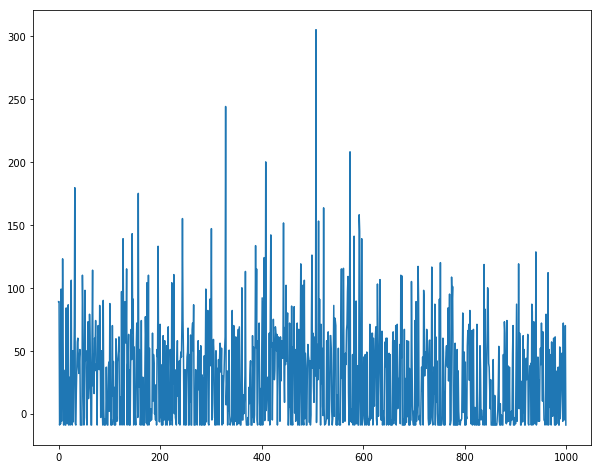

In [105]:
fig = plt.figure(figsize=(10,8))
# TODO: plot rewards 
plt.plot(X1,scaley=True,scalex=True)

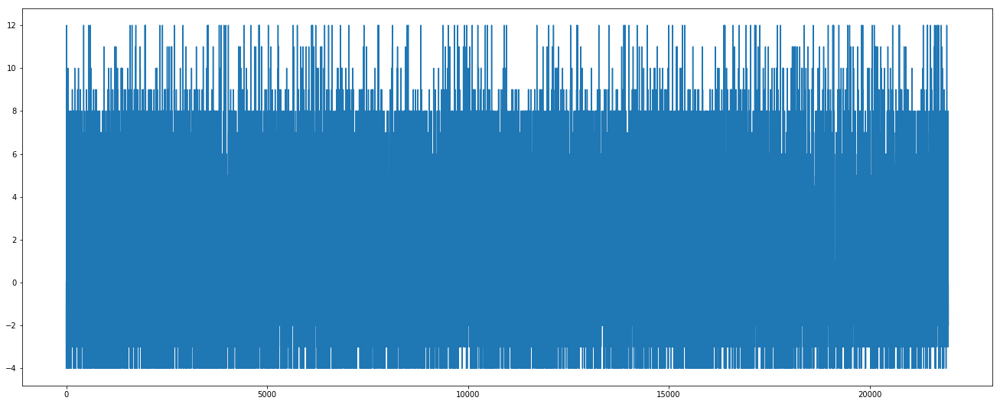

In [106]:
fig = plt.figure(figsize=(50,20))
ax = fig.add_subplot(221)
# TODO: plot rewards 
plt.plot(Y1)

In [107]:
playerwincount=0
for m in Y1:
    if m>0:
        playerwincount+=1
print(playerwincount)
print("Total count:",len(Y1))

9126
Total count: 21961


In [108]:
X_test1,Y_test1=rap1.test(10)

I am in the test function
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [5, 9, 1]}
Available actions for: prajval are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
computer2 plays 2.
Available actions for: prashant are [0, 1]
prashant folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7, 1], [13.0, 1]], 'total_pot_balance': 3, 'player_stats': [3, 7, 1]}
Available actions for: prajval are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 plays 1.
Available actions for: prashant are [0, 1]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [10.0, 1]], 'total_pot_balance': 3, 'player_stats': [11, 5, 1]}
Available actions fo

In [109]:
playerwincount=0
for m in Y_test1:
    if m>0:
        playerwincount+=1
print(playerwincount)
print("Total count:",len(Y_test1))

63
Total count: 192


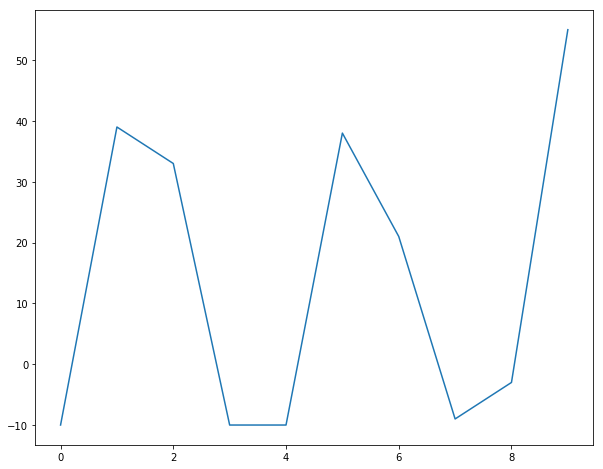

In [110]:
fig = plt.figure(figsize=(10,8))
# TODO: plot rewards 
plt.plot(X_test1,scaley=True,scalex=True)

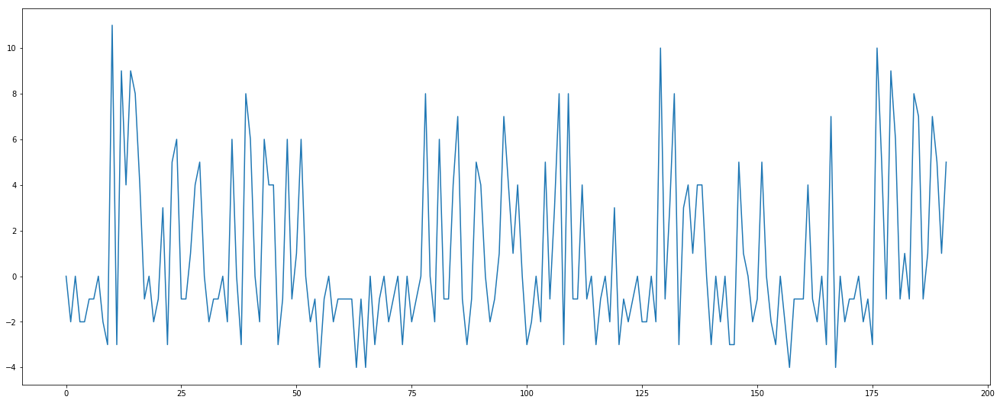

In [111]:
fig = plt.figure(figsize=(50,20))
ax = fig.add_subplot(221)
# TODO: plot rewards 
plt.plot(Y_test1)

#### With Aplha=0.9

In [112]:
poker = Poker(number_of_player=3)
player1 = Player("prashant", start_balance = 10, is_computer =  0)
computer1 = Player("computer1", start_balance = 10, is_computer = 1)
computer2 = Player("computer2", start_balance = 10, is_computer = 1)
poker.add_player(player1)
poker.add_player(computer1)
poker.add_player(computer2)

rap2=RLAgentPoker(poker)

X2,Y2=rap2.train(gamma=0.99, 
                                   alpha=0.9, 
                                   epsilon=1.0, 
                                   maxiter=1000
                                   )
  

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [8, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1], [5, 1]], 'total_pot_balance': 3, 'player_stats': [3, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [12, 3, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant plays 1.
computer1 plays 2.
computer2 plays 2.
Available action

Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 23.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_s

Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 21.0, 1]}
Available actions 

prashant folds
computer1 folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1], [7.0, 1]], 'total_pot_balance': 3, 'player_stats': [9, 7, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
computer2 folds
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1], [6.0, 1]], 'total_pot_balance': 3, 'player_stats': [8, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1], [3.0, 1]], 'total_pot_balance': 3, 'pl

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 18, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 19, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance':

computer1 folds
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8, 1], [13.0, 1]], 'total_pot_balance': 3, 'player_stats': [11, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer2 plays 2.
computer1 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4, 1], [10.0, 1]], 'total_pot_balance': 3, 'player_stats': [7, 13, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_ba

Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 13.0, 1]}
Av

prashant folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 12, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 11, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 13, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
**************************************************
---------------------

Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 9.0, 1]}
Available 

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4, 1], [18.0, 1]], 'total_pot_balance': 3, 'player_stats': [9, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [8, 11, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2.5, 1], [14.5, 1]], 'total_pot_balance': 3, 'player_stats': [3, 10, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 folds
Computer folds, Player

Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer1 folds
**************************************************
------------------------------------------

Start State: {'other_stats': [[13.5, 1], [7.5, 1]], 'total_pot_balance': 3, 'player_stats': [5, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.5, 1], [11.5, 1]], 'total_pot_balance': 3, 'player_stats': [3, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 plays 2.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.5, 1], [15.5, 1]], 'total_pot_balance': 3, 'player_stats': [7, 4, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 plays 3.
Available actions for: Prashant are [0]
prashant folds
**************************************************
----------------------------

Start State: {'other_stats': [[19.0, 1], [2.0, 1]], 'total_pot_balance': 3, 'player_stats': [2, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer2 folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1], [1.0, 1]], 'total_pot_balance': 3, 'player_stats': [3, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_

computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1], [9.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [17.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 1, 1]}
Available actions for: Prashant are [0]
prashant folds
computer1 plays 1.
computer2 plays 2.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [7, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 plays 3.
Available actio

computer1 plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [2, 1]], 'total_pot_balance': 3, 'player_stats': [11, 13, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 plays 1.
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 18, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_ba

prashant plays 1.
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1], [8.0, 1]], 'total_pot_balance': 3, 'player_stats': [10, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1], [4.0, 1]], 'total_pot_balance': 3, 'player_stats': [4, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
computer2 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1], [1.0, 1]], 'total_pot_balance': 3, 'player_stats': [6, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
co

Deal Start!
Start State: {'other_stats': [[8.5, 1], [10.0, 1]], 'total_pot_balance': 3, 'player_stats': [2, 8.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 plays 1.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.5, 1], [12.0, 1]], 'total_pot_balance': 3, 'player_stats': [7, 4.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
computer2 plays 3.
Available actions for: Prashant are [0]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.5, 1], [18.0, 1]], 'total_pot_balance': 3, 'player_stats': [3, 2.5, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant folds
computer1 plays 2.
computer2 folds
**************************************************
-------------

prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.5, 1]], 'total_pot_balance': 2, 'player_stats': [4, 6.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.5, 1]], 'total_pot_balance': 2, 'player_stats': [3, 9.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.5, 1]], 'total_pot_balance': 2, 'player_stats': [3, 8.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: 

Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 2.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_s

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
****

Start State: {'other_stats': [[10.0, 1], [13.0, 1]], 'total_pot_balance': 3, 'player_stats': [4, 4, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [15.0, 1]], 'total_pot_balance': 3, 'player_stats': [8, 3, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant folds
computer1 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant folds
computer1 plays 2.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1],

Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 23.0, 1]}
Available

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 26.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 26.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [11, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
compu

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [4, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 plays 2.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [12, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer2 folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2, 1], [13.0, 1]], 'total_pot_balance': 3, 'player_stats': [8, 12, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer2 plays 1.
computer1

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [15.0, 1]], 'total_pot_balance': 3, 'player_stats': [8, 3, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant plays 1.
computer1 plays 2.
computer2 folds
Available actions for: Prashant are [0]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [12, 1, 1]}
Available actions for: Prashant are [0]
prashant folds
computer1 plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [4, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer2 plays 1.


--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [12.0, 1]], 'total_pot_balance': 3, 'player_stats': [2, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 folds
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [2, 3, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant plays 2.
computer1 plays 3.
computer2 plays 2.
Available actions for: Prashant are [0]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [7, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
c

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [11, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6, 1], [8, 1]], 'total_pot_balance': 3, 'player_stats': [2, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
computer2 plays 1.
Available actions for: Prashant are [0, 2]
prashant folds
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1], [6, 1]], 'total_pot_balance': 3, 'player_stats': [13, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
compu

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1], [2, 1]], 'total_pot_balance': 3, 'player_stats': [6, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1], [4.0, 1]], 'total_pot_balance': 3, 'player_stats': [10, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer2 plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 12, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer1 folds
**************************************************
-------------------------------------

Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot

Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 18.0

Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 13

Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [5, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer2 folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7, 1], [8, 1]], 'total_pot_balance': 3, 'player_stats': [13, 12, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 plays 2.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4, 1], [12.0, 1]], 'total_pot_balance': 3, 'player_stats': [10, 11, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer2 plays 2.
computer1 folds
computer2 folds
**************************************************
--------------------------------

Available actions for: Prashant are [0]
prashant folds
computer1 plays 2.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [5, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1], [6, 1]], 'total_pot_balance': 3, 'player_stats': [2, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer2 plays 1.
computer1 plays 1.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1], [8.0, 1]], 'total_pot_balance': 3, 'player_stats

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
-------------------------------------------------

prashant plays 3.
computer1 plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
**************************************************
------------

computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.5, 1]], 'total_pot_balance': 2, 'player_stats': [9, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.5, 1]], 'total_pot_balance': 2, 'player_stats': [12, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.5, 1]], 'total_pot_balance': 2, 'player_stats': [7, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer1 folds
**************************************************


computer1 plays 1.
computer2 folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [6, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer2 plays 1.
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [3, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6, 1], [16.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.


Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1], [7, 1]], 'total_pot_balance': 3, 'player_stats': [2, 7, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1], [4, 1]], 'total_pot_balance': 3, 'player_stats': [11, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_s

Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance'

computer2 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.5, 1]], 'total_pot_balance': 2, 'player_stats': [11, 12.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.5, 1]], 'total_pot_balance': 2, 'player_stats': [10, 16.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.5, 1]], 'total_pot_balance': 2, 'player_stats': [13, 17.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
------------------------------

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_b

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
-----------------------------

Start State: {'other_stats': [[15.0, 1], [10.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant folds
computer1 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1], [9.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 1, 1]}
Available actions for: Prashant are [0]
prashant folds
computer1 plays 3.
computer2 plays 1.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [7, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6, 1], [8, 1]

computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6, 1], [13.0, 1]], 'total_pot_balance': 3, 'player_stats': [7, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer2 plays 1.
computer1 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [8, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1], [7.0, 1]], 'total_pot_balance': 3, 'player_stats': [8, 13, 1]}
Availa

Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
pras

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 22, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 23, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 19, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: 

Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1

Start State: {'other_stats': [[17.0, 1], [7.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 3.0, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant folds
computer1 plays 2.
computer2 plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [10, 2.0, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 plays 3.
computer2 folds
Available actions for: Prashant are [0]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [4, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 plays 2.
computer2 plays 1.
**************************************************
------------------------

computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
compute

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1], [13.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 3, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant folds
computer1 plays 3.
computer2 plays 2.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1], [9.0, 1]], 'total_pot_balance': 3, 'player_stats': [4, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [13, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 folds
*********************************

Start State: {'other_stats': [[10.0, 1], [1.0, 1]], 'total_pot_balance': 3, 'player_stats': [7, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 17.0, 1

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
***************

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 plays 1.
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1], [3, 1]], 'total_pot_balance': 3, 'player_stats': [11, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1]], 'total_pot_balance': 2, 'player_s

computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
De

Deal Start!
Start State: {'other_stats': [[8.0, 1], [1, 1]], 'total_pot_balance': 3, 'player_stats': [3, 18, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer2 folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 15, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
-----------------------------------------

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance'

prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions fo

Start State: {'other_stats': [[5, 1], [17.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2, 1], [24.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 1, 1]}
Available actions for: Prashant are [0]
prashant folds
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [3, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
computer2 folds
**************************************************
----------------------------------------------

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.5, 1]], 'total_pot_balance': 2, 'player_stats': [12, 21.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.5, 1]], 'total_pot_balance': 2, 'player_stats': [4, 22.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.5, 1]], 'total_pot_balance': 2, 'player_stats': [7, 21.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.5, 1]], 'total_pot_balance'

prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
*************************

Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**********************

Start State: {'other_stats': [[24.5, 1]], 'total_pot_balance': 2, 'player_stats': [6, 3.0, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.5, 1]], 'total_pot_balance': 2, 'player_stats': [13, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[23.5, 1]], 'total_pot_balance': 2, 'player_stats': [4, 4.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[24.5, 1]], 'total_pot_balance': 2, 'player_stats': [5, 3.0, 1]}
Available actions for: Prash

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
D

prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1], [5, 1]], 'total_pot_balance': 3, 'player_stats': [5, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer2 folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1], [4, 1]], 'total_pot_balance': 3, 'player_stats': [3, 10, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [6.0, 1]], 'total_pot_balance': 3, 'player_stats': [4, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 plays 3.
************

Available actions for: Prashant are [0]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [12, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1], [5, 1]], 'total_pot_balance': 3, 'player_stats': [4, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1], [4, 1]], 'total_pot_balance': 3, 'player_stats': [13, 1, 1]}
Available actions for: Prashant are [0]
prashant folds
computer1 plays 1.
c

computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1], [8.0, 1]], 'total_pot_balance': 3, 'player_stats': [12, 1.0, 1]}
Available actions for: Prashant are [0]
prashant folds
computer1 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [5, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer2 folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6, 1], [8, 1]], 'total_pot_balance': 3, 'player_stats': [3, 13, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
computer2 folds
*****************************

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.5, 1]], 'total_pot_balance': 2, 'player_stats': [13, 5.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.5, 1]], 'total_pot_balance': 2, 'player_stats': [4, 9.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.5, 1]], 'total_pot_balance': 2, 'player_stats': [5, 7.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.5, 1]], 'total_pot_b

Deal Start!
Start State: {'other_stats': [[15.0, 1], [6, 1]], 'total_pot_balance': 3, 'player_stats': [5, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 plays 1.
Available actions for: Prashant are [0, 1]
prashant folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1], [2, 1]], 'total_pot_balance': 3, 'player_stats': [8, 3, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant folds
computer1 plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[24.0, 1], [1, 1]], 'total_pot_balance': 3, 'player_stats': [13, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 plays 2.
computer2 folds
Available actions for: Prashant are [0]
prashant folds
***************************

prashant plays 3.
computer1 plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 26.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
***

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
-

computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
***************************

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant p

prashant folds
computer1 folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2, 1], [22.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 3, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant plays 1.
computer1 folds
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1, 1], [21.0, 1]], 'total_pot_balance': 3, 'player_stats': [8, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[23.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 4, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**********************************

computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal 

prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
----------

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[24.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 3.0, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
-------------------------------------------------

computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [7, 1]], 'total_pot_balance': 3, 'player_stats': [3, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1], [13.0, 1]], 'total_pot_balance': 3, 'player_stats': [7, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1], [16.0, 1]], 'total_pot_balance': 3, 'player_stats': [3, 5, 1]}
Available action

computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1], [13.0, 1]], 'total_pot_balance': 3, 'player_stats': [12, 4.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer2 folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1], [12.0, 1]], 'total_pot_balance': 3, 'player_stats': [9, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [7, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer2 plays

prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [8, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8, 1], [12.0, 1]], 'total_pot_balance': 3, 'player_stats': [2, 7, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 folds
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [3, 5, 1]}
A

Start State: {'other_stats': [[12.0, 1], [7, 1]], 'total_pot_balance': 3, 'player_stats': [8, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1], [6, 1]], 'total_pot_balance': 3, 'player_stats': [4, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 folds
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1], [5, 1]], 'total_pot_balance': 3, 'player_stats': [9, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
***************************************

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[24.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 3.0, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[25.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 2.0, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 plays 2.
Available actions for: Prashant are [0]
prashant folds
************

prashant plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.5, 1]], 'total_pot_balance': 2, 'player_stats': [9, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.5, 1]], 'total_pot_balance': 2, 'player_stats': [12, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.5, 1]], 'total_pot_balance': 2, 'player_stats': [11, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2,

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [6, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 plays 1.
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1], [7.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 1, 1]}
Available actions for: Prashant are [0]
prashant folds
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [3, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 folds
Available actions for: Pra

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 folds
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [5, 1]], 'total_pot_balance': 3, 'player_stats': [5, 10, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1], [1, 1]], 'total_pot_balance': 3, 'player_stats': [4, 7, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [

Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[3.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 24.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State:

Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'to

prashant plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 2.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 23.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 26.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
************************************************

computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [9.0, 1]], 'total_pot_balance': 3, 'player_stats': [7, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 4.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1], [18.0, 1]], 'total_pot_balance': 3, 'player_sta

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.5, 1]], 'total_pot_balance': 2, 'player_stats': [7, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.5, 1]], 'total_pot_balance': 2, 'player_stats': [3, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.5, 1]], 'total_pot_balance': 2, 'player_stats': [8, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 1.
********************************

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 23.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 26.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [10, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 plays 

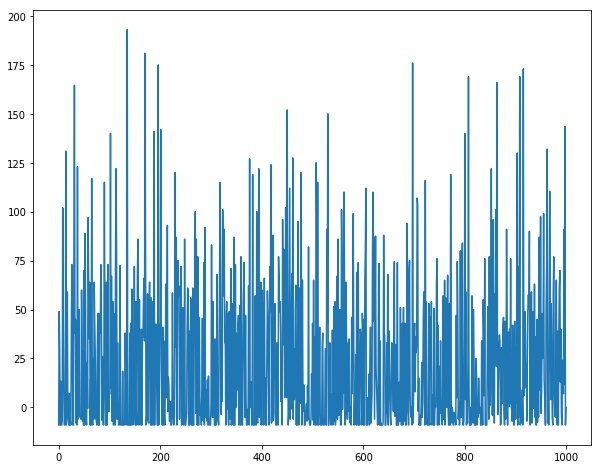

In [113]:
fig = plt.figure(figsize=(10,8))
# TODO: plot rewards 
plt.plot(X2,scaley=True,scalex=True)

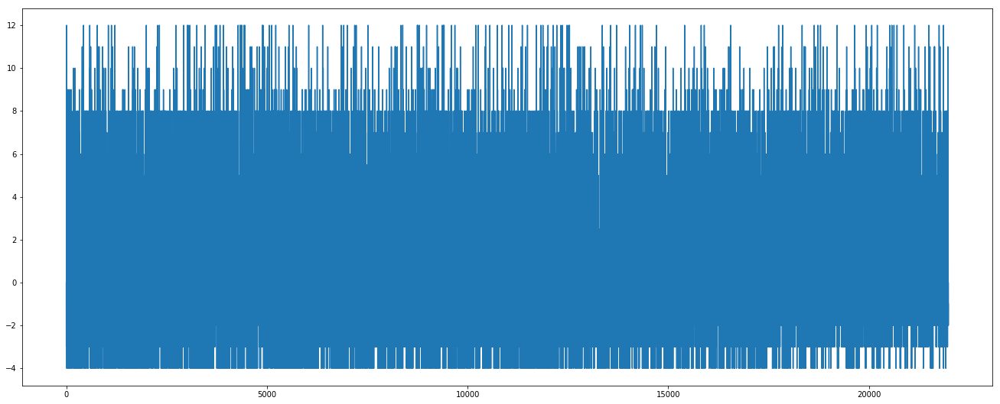

In [114]:
fig = plt.figure(figsize=(50,20))
ax = fig.add_subplot(221)
# TODO: plot rewards 
plt.plot(Y2)

In [115]:
playerwincount=0
for m in Y2:
    if m>0:
        playerwincount+=1
print(playerwincount)
print("Total count:",len(Y2))

8440
Total count: 21983


In [116]:
X_test2,Y_test2=rap2.test(10)

I am in the test function
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [10, 9, 1]}
Available actions for: prajval are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
computer2 plays 3.
Available actions for: prashant are [0, 2]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1], [5, 1]], 'total_pot_balance': 3, 'player_stats': [6, 7, 1]}
Available actions for: prajval are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1], [9.0, 1]], 'total_pot_balance': 3, 'player_stats': [10, 5, 1]}
Available actions for: prajval are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 fo

In [117]:
playerwincount=0
for m in Y_test2:
    if m>0:
        playerwincount+=1
print(playerwincount)
print("Total count:",len(Y_test2))

41
Total count: 170


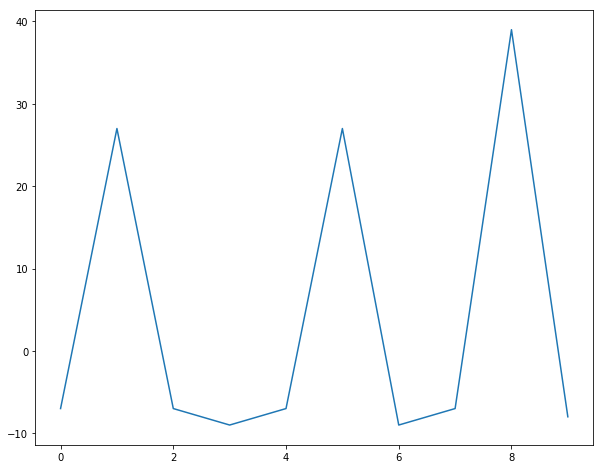

In [118]:
fig = plt.figure(figsize=(10,8))
# TODO: plot rewards 
plt.plot(X_test2,scaley=True,scalex=True)

<b>Choosing Alpha as 0.9 Now trying different Gamma values

#### Gamma 0.1

In [127]:
poker = Poker(number_of_player=3)
player1 = Player("prashant", start_balance = 10, is_computer =  0)
computer1 = Player("computer1", start_balance = 10, is_computer = 1)
computer2 = Player("computer2", start_balance = 10, is_computer = 1)
poker.add_player(player1)
poker.add_player(computer1)
poker.add_player(computer2)

rap4=RLAgentPoker(poker)

X1,Y1=rap4.train(gamma=0.1, 
                                   alpha=0.9, 
                                   epsilon=1.0, 
                                   maxiter=1000
                                   )

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [7, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 folds
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1], [8, 1]], 'total_pot_balance': 3, 'player_stats': [3, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [13.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer2 plays 2.
computer1 plays 1.
*****************

prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[26.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 1, 1]}
Available actions for: Prashant are [0]
prashant folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [3, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [12, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer2 plays 1.
computer1 plays 1.
computer2 folds
****************************

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
----------------------------

prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available 

computer1 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 8.0, 1]

prashant plays 1.
computer1 folds
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [7.0, 1]], 'total_pot_balance': 3, 'player_stats': [3, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1], [10.0, 1]], 'total_pot_balance': 3, 'player_stats': [6, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [13.0, 1]], 'total_pot_balance': 3, 'player_stats': [9, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
compu

Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------

computer2 plays 3.
Available actions for: Prashant are [0]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.5, 1], [13.0, 1]], 'total_pot_balance': 3, 'player_stats': [7, 1.5, 1]}
Available actions for: Prashant are [0, 1]
prashant folds
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.5, 1], [15.0, 1]], 'total_pot_balance': 3, 'player_stats': [11, 0.5, 1]}
Available actions for: Prashant are [0]
prashant folds
computer1 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [9, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
compute

prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 26.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [3, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [4, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 plays 2.
Available actions 

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1], [10.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 4, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [12.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 3, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant plays 2.
computer1 folds
computer2 plays 3.
Available actions for: Prashant are [0]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [10, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer2 folds
computer1 folds
*****************************

Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 14.0, 1]}

computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
*******************************************

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 19, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 16, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 15, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**

computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1], [4, 1]], 'total_pot_balance': 3, 'player_stats': [7, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [3, 1]], 'total_pot_balance': 3, 'player_stats': [12, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1], [1, 1]], 'total_pot_balance': 3, 'player_stats': [3, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
computer2 folds
Avail

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[24.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 3.0, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[24.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 3.0, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[23.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 4.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
***********************************************

computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 3.
Available actions for: Prashant are [0

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
De

Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[3.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 24.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
---------------------------------------------

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2.5, 1], [20.5, 1]], 'total_pot_balance': 3, 'player_stats': [8, 4, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 plays 1.
Available actions for: Prashant are [0, 1]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[25.5, 1]], 'total_pot_balance': 2, 'player_stats': [6, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[26.5, 1]], 'total_pot_balance': 2, 'player_stats': [6, 1, 1]}
Available actions for: Prashant are [0]
prashant folds
computer2 plays 3.
**************************************************
------------------------------------

Start State: {'other_stats': [[24.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 3.0, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[25.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 2.0, 1]}
Available actions for: Prashant are [0, 1]
prashant folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[25.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 2.0, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8, 1], [6, 1]], 'total_pot_balance': 3, 'player_stats': [9, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7, 1], [6.5, 1]], 'total_pot_balance': 3, 'player_stats': [11, 13.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer2 plays 2.
computer1 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[3, 1], [2.5, 1]], 'total_pot_balance': 3, 'player_stats': [3, 21.5, 1]}
Ava

computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 25.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
*******************************************

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [16.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [7, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer2 folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1], [13.0, 1]], 'total_pot_balance': 3, 'player_stats': [2, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 plays 2.
computer2 plays 1.
**************************************************
-------

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
************

Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 folds
**************

prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[26.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 1.5, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[24.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 3.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[23.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 4.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal 

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [7, 1]], 'total_pot_balance': 3, 'player_stats': [9, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 plays 2.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [11, 7, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1], [9.0, 1]], 'total_pot_balance': 3, 'player_stats': [3, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 plays 2.
computer2 folds
**************************************************
-------

Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'othe

Start State: {'other_stats': [[6.5, 1]], 'total_pot_balance': 2, 'player_stats': [8, 20.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.5, 1]], 'total_pot_balance': 2, 'player_stats': [10, 21.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[3.5, 1]], 'total_pot_balance': 2, 'player_stats': [10, 23.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.5, 1]], 'total_pot_balance': 2, 'player_stats': [3, 19.5, 1]}
Avail

prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 6.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 7.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 10.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
------------------------------

Deal Start!
Start State: {'other_stats': [[1, 1], [4.0, 1]], 'total_pot_balance': 3, 'player_stats': [7, 22, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 25, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 26, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'pla

computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1], [17.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant folds
computer1 plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1], [16.0, 1]], 'total_pot_balance': 3, 'player_stats': [4, 1, 1]}
Available actions for: Prashant are [0]
prashant folds
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [6, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
computer2 folds
*************************************************

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1], [15.0, 1]], 'total_pot_balance': 3, 'player_stats': [2, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [4, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 folds
Computer folds, Player fo

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!


**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------

Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 plays 1.
computer2 plays 3.
Available actions for: Prashant are [0]
prashant folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [6, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8, 1], [12.0, 1]],

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
-----

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1], [8.0, 1]], 'total_pot_balance': 3, 'player_stats': [6, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 plays 2.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [5.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
computer2 plays 2.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1], [1.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
computer2 folds
*********************************************

Available actions for: Prashant are [0, 1]
prashant folds
computer1 folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2.0, 1], [23.0, 1]], 'total_pot_balance': 3, 'player_stats': [4, 2.0, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [10, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
computer2 plays 1.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [10, 5, 1]}
Available a

prashant plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 25.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 26.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [8, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 3.
**************************************************
-------------------

Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 13.0, 1]}
Available a

Deal Start!
Start State: {'other_stats': [[8.0, 1], [17.0, 1]], 'total_pot_balance': 3, 'player_stats': [3, 2.0, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 plays 2.
computer2 plays 1.
Available actions for: Prashant are [0]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [10, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1], [5, 1]], 'total_pot_balance': 3, 'player_stats': [4, 7, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 folds
Available actions

prashant plays 3.
computer1 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 7.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 plays 1.
****

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 13.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------


--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer1 folds
*****************************

computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 2.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 1]
prashant folds
*

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1, 1], [21.0, 1]], 'total_pot_balance': 3, 'player_stats': [12, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
computer2 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant plays 2.
****************

Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 21.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 2.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.5, 1]], 'total_pot_balance': 2, 'player_stats': [12, 11.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.5, 1]], 'total_pot_balance': 2, 'player_stats': [6, 15.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.5, 1]], 'total_pot_balance': 2, 'player_stats': [9, 14.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2

Start State: {'other_stats': [[13.0, 1], [12.0, 1]], 'total_pot_balance': 3, 'player_stats': [11, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant folds
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [8, 1, 1]}
Available actions for: Prashant are [0]
prashant folds
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [10, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer2 folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[6, 1], [8, 1]], 't

Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 2.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 19.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'pl

prashant plays 1.
computer1 plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[3, 1], [15.0, 1]], 'total_pot_balance': 3, 'player_stats': [7, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2, 1], [13.0, 1]], 'total_pot_balance': 3, 'player_stats': [2, 12, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1, 1], [15.0, 1]], 'total_pot_balance': 3, 'player_stats': [7, 11, 1]}
Availa

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [5, 1]], 'total_pot_balance': 3, 'player_stats': [6, 10, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1], [8.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1], [12.0, 1]], 'total_pot_balance': 3, 'player_stats': [3, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
computer2 folds
**************************************************
--------------------------------------------

Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1], [13.0, 1]], 'total_pot_balance': 3, 'player_stats': [2, 3.0, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant plays 1.
computer1 folds
computer2 plays 3.
Available actions for: Prashant are [0]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1], [16.0, 1]], 'total_pot_balance': 3, 'player_stats': [6, 1.0, 1]}
Available actions for: Prashant are [0]
prashant folds
computer1 folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1], [16.0, 1]], 'total_pot_balance': 3, 'player_stats': [3, 1.0, 1]}
Available 

prashant plays 3.
computer1 plays 3.
computer2 plays 2.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5, 1], [17.0, 1]], 'total_pot_balance': 3, 'player_stats': [4, 5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer2 folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [16.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [11, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prasha

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8, 1], [7, 1]], 'total_pot_balance': 3, 'player_stats': [10, 12, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7, 1], [6, 1]], 'total_pot_balance': 3, 'player_stats': [2, 14, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer2 plays 3.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [8.0, 1]], 'total_pot_balance': 3, 'player_stats': [3, 10, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 2.
**********************************

computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.5, 1]], 'total_pot_balance': 2, 'player_stats': [11, 9.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.5, 1]], 'total_pot_balance': 2, 'player_stats': [6, 13.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.5, 1]], 'total_pot_balance': 2, 'player_stats': [4, 11.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
***********************************

Start State: {'other_stats': [[23.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 4, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1]], 'tot

prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer1 plays 1.
*********************************************

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.5, 1]], 'total_pot_balance': 2, 'player_stats': [2, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.5, 1]], 'total_pot_balance': 2, 'player_stats': [9, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.5, 1]], 'total_pot_balance': 2, 'player_stats': [10, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
**************************************************
----------------------

computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 1.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 2.
**

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [4, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 14.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 pl

computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[5.0, 1]], 'total_pot_balance': 2, 'player_stats': [13, 22.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 2.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 26.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [3, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 plays 3.
**************************************************
---------

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.5, 1]], 'total_pot_balance': 2, 'player_stats': [4, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.5, 1]], 'total_pot_balance': 2, 'player_stats': [6, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.5, 1]], 'total_pot_balance': 2, 'player_stats': [9, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Sta

Start State: {'other_stats': [[3.5, 1], [19.5, 1]], 'total_pot_balance': 3, 'player_stats': [2, 4, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
computer2 plays 2.
Available actions for: Prashant are [0]
prashant folds
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.5, 1], [16.5, 1]], 'total_pot_balance': 3, 'player_stats': [3, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 plays 1.
computer2 plays 2.
Available actions for: Prashant are [0]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [10, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 3.
computer2 plays 1.
Available act

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1], [9.5, 1]], 'total_pot_balance': 3, 'player_stats': [11, 4.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer2 folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1], [8.5, 1]], 'total_pot_balance': 3, 'player_stats': [8, 7.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1], [15.5, 1]], 'total_pot_balance': 3, 'player_stats': [4, 3.5, 1]}
Available actions for: Prashant are [0, 1,

computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.5, 1]], 'total_pot_balance': 2, 'player_stats': [6, 16.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.5, 1]], 'total_pot_balance': 2, 'player_stats': [13, 14.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.5, 1]], 'total_pot_balance': 2, 'player_stats': [2, 18.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions f

Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer2 plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[2.0, 1], [13.5, 1]], 'total_pot_balance': 3, 'player_stats': [11, 11.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1.0, 1], [12.5, 1]], 'total_pot_balance': 3, 'player_stats': [8, 13.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[13.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 14.0, 1]}
Available actions for: Pras

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.0, 1], [5.0, 1]], 'total_pot_balance': 3, 'player_stats': [4, 2, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer1 folds
computer2 plays 2.
Available actions for: Prashant are [0]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [9, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
computer2 folds
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [8, 1]], 'total_pot_balance': 3, 'player_stats': [7, 7, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 pla

computer1 plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[0.5, 1]], 'total_pot_balance': 2, 'player_stats': [9, 26.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [9, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1], [6, 1]], 'total_pot_balance': 3, 'player_stats': [9, 7, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
com

Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[15.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 12.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[17.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 10.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[16.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 11.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 3.
Available actions for: Pr

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[4.0, 1], [3.0, 1]], 'total_pot_balance': 3, 'player_stats': [9, 20.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 2.
computer2 folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[1.0, 1], [2.0, 1]], 'total_pot_balance': 3, 'player_stats': [6, 24.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 folds
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [9, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 1.
computer2 plays 1.
computer1

Available actions for: Prashant are [0]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [2, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [9.0, 1]], 'total_pot_balance': 3, 'player_stats': [6, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
comput

**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 17.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [5, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [9, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start

prashant folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[24.0, 1]], 'total_pot_balance': 2, 'player_stats': [8, 3.0, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant plays 2.
computer2 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[21.0, 1]], 'total_pot_balance': 2, 'player_stats': [2, 6.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer2 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
*****************************

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [6, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8, 1], [11.0, 1]], 'total_pot_balance': 3, 'player_stats': [4, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [6, 6, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal St

Deal Start!
Start State: {'other_stats': [[9.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 18.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 2.
Available actions for: Prashant are [0, 1]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1]], 'total_pot_balance': 2, 'player_stats': [3, 16.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 15.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[14.0, 1]], 'to

computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [6, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[19.0, 1]], 'total_pot_balance': 2, 'player_stats': [7, 8.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[18.0, 1]], 'total_pot_balance': 2, 'player_stats': [12, 9.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 3.
**************************************************
--------------------------------------------------
De

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[20.5, 1]], 'total_pot_balance': 2, 'player_stats': [8, 6.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 plays 3.
Available actions for: Prashant are [0, 2]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[22.5, 1]], 'total_pot_balance': 2, 'player_stats': [5, 4.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[23.5, 1]], 'total_pot_balance': 2, 'player_stats': [9, 3.5, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer1 plays 2.
**************************************************
-----------------------------------------

--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[10.0, 1], [13.0, 1]], 'total_pot_balance': 3, 'player_stats': [13, 4, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 3.
computer1 plays 1.
computer2 plays 3.
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[8.0, 1], [9.0, 1]], 'total_pot_balance': 3, 'player_stats': [6, 10, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 1.
computer1 folds
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[7.0, 1], [8.0, 1]], 'total_pot_balance': 3, 'player_stats': [7, 12, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 3.
computer2 folds
**************************************************
----------------------------

Deal Start!
Start State: {'other_stats': [[6.0, 1], [19.0, 1]], 'total_pot_balance': 3, 'player_stats': [3, 2.0, 1]}
Available actions for: Prashant are [0, 1]
prashant folds
computer1 plays 3.
computer2 plays 1.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [17.0, 1]], 'total_pot_balance': 3, 'player_stats': [11, 1.0, 1]}
Available actions for: Prashant are [0]
prashant folds
computer1 folds
computer2 folds
Computer folds, Player folds !
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9.0, 1], [17.0, 1]], 'total_pot_balance': 3, 'player_stats': [12, 1.0, 1]}
Available actions for: Prashant are [0]
prashant folds
computer1 folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start Sta

Deal Start!
Start State: {'other_stats': [[10.0, 1], [14.0, 1]], 'total_pot_balance': 3, 'player_stats': [10, 3.0, 1]}
Available actions for: Prashant are [0, 1, 2]
prashant plays 2.
computer1 plays 1.
computer2 plays 3.
Available actions for: Prashant are [0]
prashant folds
computer1 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [9, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
computer2 folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1], [8, 1]], 'total_pot_balance': 3, 'player_stats': [9, 8, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 folds
Computer folds, Player folds !
**************************************************
----

Start State: {'other_stats': [[22.0, 1]], 'total_pot_balance': 2, 'player_stats': [10, 5.0, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant plays 2.
computer2 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[25.0, 1]], 'total_pot_balance': 2, 'player_stats': [11, 2.0, 1]}
Available actions for: Prashant are [0, 1]
prashant plays 1.
computer2 plays 3.
Available actions for: Prashant are [0]
prashant folds
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [4, 9, 1]}
Available actions for: Prashant are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats

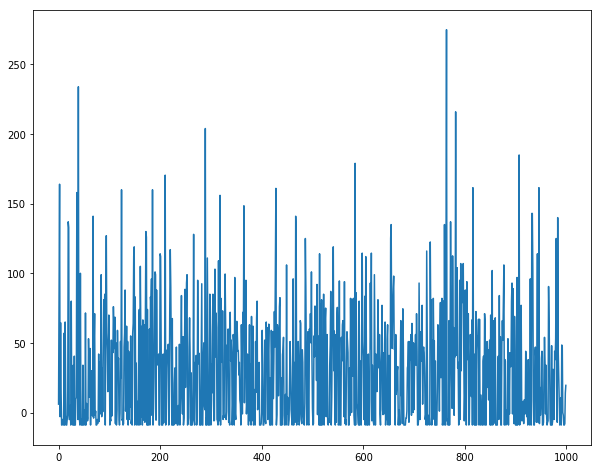

In [128]:
fig = plt.figure(figsize=(10,8))
# TODO: plot rewards 
plt.plot(X1,scaley=True,scalex=True)

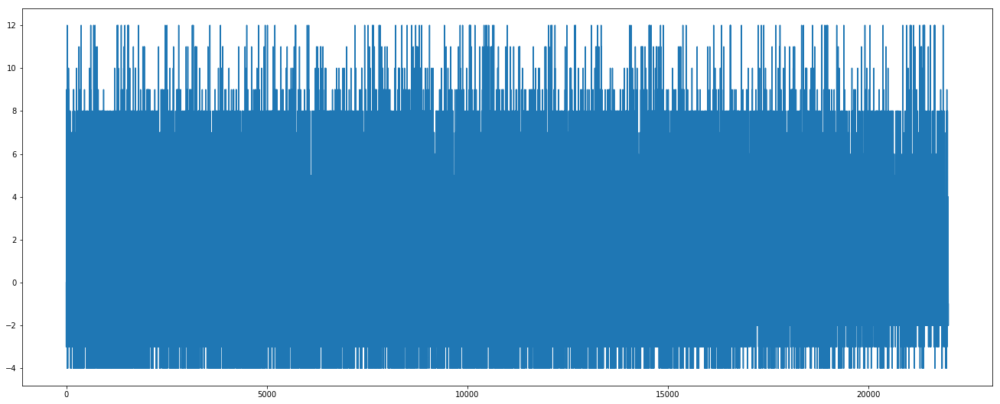

In [129]:

fig = plt.figure(figsize=(50,20))
ax = fig.add_subplot(221)
# TODO: plot rewards 
plt.plot(Y1)

In [130]:
playerwincount=0
for m in Y1:
    if m>0:
        playerwincount+=1
print(playerwincount)
print("Total count:",len(Y1))

9307
Total count: 21998


In [131]:
X_test1,Y_test1=rap4.test(10)

I am in the test function
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[9, 1], [9, 1]], 'total_pot_balance': 3, 'player_stats': [3, 9, 1]}
Available actions for: prajval are [0, 1, 2, 3]
prashant folds
computer1 plays 1.
computer2 plays 1.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[12.0, 1], [7, 1]], 'total_pot_balance': 3, 'player_stats': [9, 8, 1]}
Available actions for: prajval are [0, 1, 2, 3]
prashant folds
computer1 folds
computer2 plays 3.
**************************************************
--------------------------------------------------
Deal Start!
Start State: {'other_stats': [[11.0, 1], [9.0, 1]], 'total_pot_balance': 3, 'player_stats': [5, 7, 1]}
Available actions for: prajval are [0, 1, 2, 3]
prashant folds
computer1 plays 2.
computer2 plays 1.
computer2 plays 1.
**************************************************
-----------

In [132]:
playerwincount=0
for m in Y_test1:
    if m>0:
        playerwincount+=1
print(playerwincount)
print("Total count:",len(Y_test1))

73
Total count: 258


## Choice of Parameters for Maze Problem
As per the experiments conducted above, following paramets are chosen.
1. Epsilon=1.0 We are chosing this as 1 as we are using a decay function
2. Aplha=0.9
3. Gamma=0.1

We are comparing how the agent perfroms for test and train runs by comparing the number of matches the player wins and comparing the graphs of rewards earned after every deal and a complate game. 

## Analysis of learning Results:
1. The plot of rewards contantly varies indicating not a good learning pattern. 
2. As the value of Gamma decreases the winning rate decreases. 
3. As the value of alpha increases , the winning rate decreases.

# V. Conclusions

1. We have implement agents for the maze problem and One Card Poker Problem with Q learning approach.
2. The Epsilon paramter causes a huge tradeoff in the quality of learning. Thus a decay method was used.
3. The Q table for poker became quite huge hence there was a need to cut on the patamereters to consider as a state.
4. Defining the state space for Poker was quite challenging. 
5. Initializing the Q matrix with random values in Poker problem produced better results.

## References
1. https://stats.stackexchange.com/questions/326788/when-to-choose-sarsa-vs-q-learning
2. https://medium.freecodecamp.org/diving-deeper-into-reinforcement-learning-with-q-learning-c18d0db58efe